## **Connecting to Google Drive**

In [ ]:
# Import the drive module from google.colab to mount Google Drive
from google.colab import drive

# Mount Google Drive to the Colab environment
# This will prompt you to authorize access to your Google Drive account
drive.mount('/content/drive')

# Define the path to the training dataset located in Google Drive
data_root = '/content/drive/MyDrive/animal/Train'

# Define the path to the test dataset located in Google Drive
data_test = '/content/drive/MyDrive/animal/Test'


Mounted at /content/drive


## **Python Liabrires**

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
%matplotlib inline

import cv2
import os
os.environ["TF_CPP_MIN_LOG_LEVEL"] = "2"
import warnings
warnings.filterwarnings('ignore')

from sklearn.metrics import confusion_matrix, classification_report, precision_recall_fscore_support
from sklearn.utils import class_weight

import tensorflow as tf
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Activation, BatchNormalization, Conv2D, Dense, Dropout, Flatten, MaxPooling2D
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras import layers, models , regularizers, optimizers
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.losses import CategoricalCrossentropy
from tensorflow.keras.regularizers import l2
from tensorflow.keras.callbacks import ReduceLROnPlateau, EarlyStopping

from tensorflow.keras.applications import VGG19
from tensorflow.keras.applications import ResNet50
from tensorflow.keras.applications import MobileNetV2
from tensorflow.keras.applications import InceptionV3

## **Data Preprocessing**

In [ ]:
# Define image dimensions and batch size
img_width, img_height = 150, 150
batch_size = 64
Training_data_dir = str(data_root)
Testing_data_dir = str(data_test)

# Data Augmentation for the training set
# The ImageDataGenerator will apply random transformations to the training images
# This helps in reducing overfitting and improving the model's generalization
train_datagen = ImageDataGenerator(
    rotation_range=10,
    rescale=1.0/255,
    zoom_range=0.2,
    horizontal_flip=True,
    fill_mode='nearest')

validation_datagen = ImageDataGenerator(rescale=1.0/255,validation_split=.20)
test_datagen = ImageDataGenerator(rescale=1.0/255)


# Data generator for the training set
train_generator = train_datagen.flow_from_directory(
    Training_data_dir,
    target_size=(img_width, img_height),
    batch_size=batch_size,
    subset="training",
    class_mode='categorical',
    shuffle=True)

# Data generator for the validation set
validation_generator = validation_datagen.flow_from_directory(
    Training_data_dir,
    target_size=(img_width, img_height),
    batch_size=batch_size,
    subset="validation",
    class_mode='categorical',
    shuffle=True)

# Data generator for the test set
test_generator = test_datagen.flow_from_directory(
    Testing_data_dir,
    target_size=(img_width, img_height),
    batch_size=batch_size,
    class_mode='categorical',
    shuffle=False)

# Map class indices to their respective class labels
labels = {value: key for key, value in train_generator.class_indices.items()}

# Print the label mappings to understand which index corresponds to which class
print("Label Mappings for classes present in the training and validation datasets\n")
for key, value in labels.items():
    print(f"{key} : {value}")


Found 5964 images belonging to 6 classes.
Found 1191 images belonging to 6 classes.
Found 759 images belonging to 6 classes.
Label Mappings for classes present in the training and validation datasets

0 : Cheetah
1 : Elephant
2 : Giraffe
3 : Lion
4 : Rhino
5 : Zebra


 This cell sets up the image preprocessing and data augmentation pipeline. It configures ImageDataGenerator to apply transformations to training images (e.g., rotation, scaling, flipping) for better generalization. It then creates data generators for training, validation, and testing datasets, allowing efficient loading and preprocessing.

## **Class Weight**

In [ ]:
# Calculate class weights to handle class imbalance
# This ensures that classes with fewer samples are given higher weight during training
# 'balanced' mode uses the formula: n_samples / (n_classes * np.bincount(y))
class_weights = class_weight.compute_class_weight(
    class_weight='balanced',
    classes=np.unique(train_generator.classes),
    y=train_generator.classes
)

# Convert class weights to a dictionary format required by Keras
class_weights_dict = {i: class_weights[i] for i in range(len(class_weights))}
print("Class Weights:", class_weights_dict)

Class Weights: {0: 1.1721698113207548, 1: 1.0463157894736843, 2: 1.004040404040404, 3: 0.9851337958374629, 4: 0.9019963702359347, 5: 0.9333333333333333}


## **Visualization**

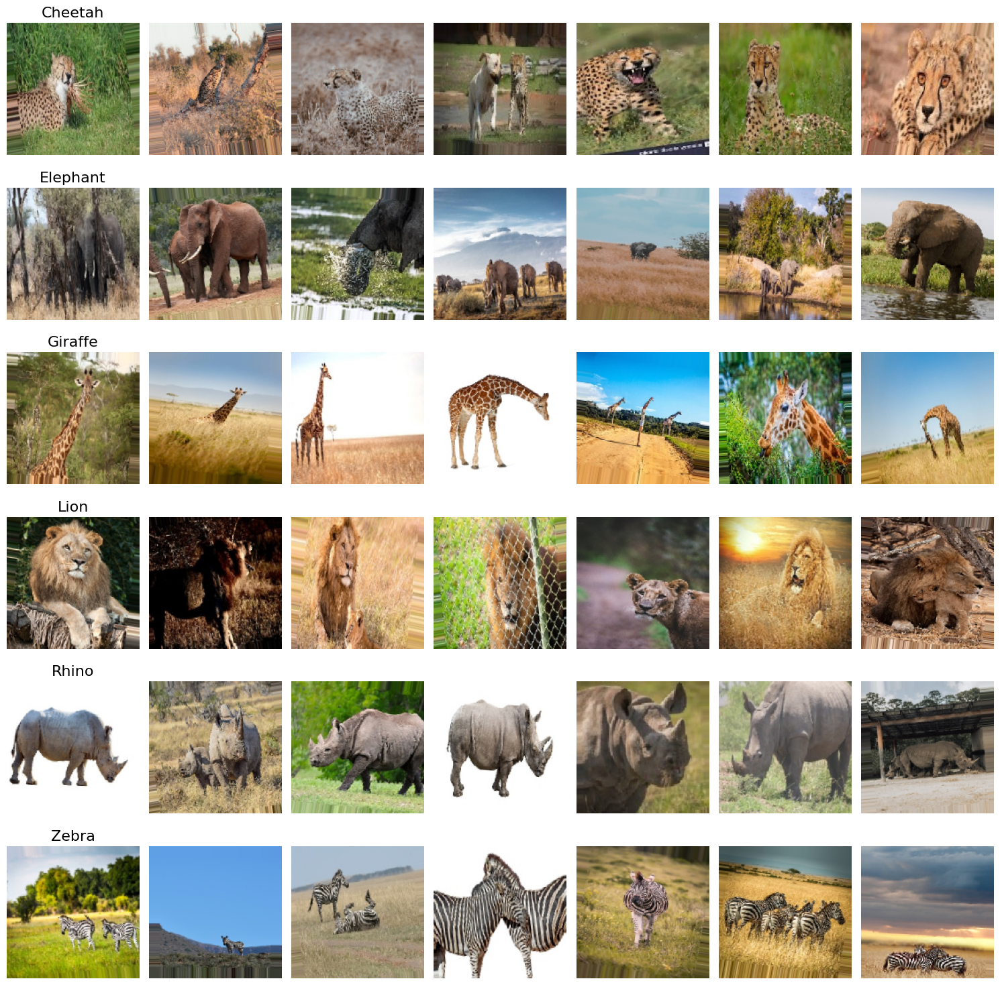

In [ ]:
# Function to plot images in a grid
def plot_images(images, labels, class_names, num_classes, num_images_per_class):
    fig, axes = plt.subplots(num_classes, num_images_per_class, figsize=(15, 15))

    for i in range(num_classes):
        class_images = images[labels == i][:num_images_per_class]
        for j in range(num_images_per_class):
            if j < len(class_images):
                axes[i, j].imshow(class_images[j])
            axes[i, j].axis('off')
            if j == 0:
                axes[i, j].set_title(class_names[i], fontsize=16)

    plt.tight_layout()
    plt.show()

# Extract a batch of images and their labels from the generator
num_classes = len(labels)
num_images_per_class = 7
all_images = []
all_labels = []

# Iterate through the data until we have enough images for each class
for _ in range(int(np.ceil(num_classes * num_images_per_class / batch_size))):
    images, image_labels = next(train_generator)
    all_images.append(images)
    all_labels.append(image_labels)

# Concatenate all images and labels
all_images = np.concatenate(all_images)
all_labels = np.concatenate(all_labels)

# Convert one-hot labels to class indices
all_labels = np.argmax(all_labels, axis=1)

# Get class names
class_names = [labels[i] for i in range(num_classes)]

# Plot the images
plot_images(all_images, all_labels, class_names, num_classes, num_images_per_class)


## **Transfer Learning**

### **MobileNetV2**

#### Training

In [ ]:

# Load MobileNetV2 model pre-trained on ImageNet, without the top classification layer
base_model = MobileNetV2(input_shape=(img_width, img_height, 3), include_top=False, weights='imagenet')

# Unfreeze some layers of the base model
base_model.trainable = True
fine_tune_at = 100

for layer in base_model.layers[:fine_tune_at]:
    layer.trainable = False

# Add custom layers on top
x = base_model.output
x = layers.GlobalAveragePooling2D()(x)
x = layers.Dense(4096, activation='relu', kernel_regularizer=regularizers.l2(0.01))(x)
x = layers.Dropout(0.5)(x)
x = layers.Dense(2048, activation='relu', kernel_regularizer=regularizers.l2(0.01))(x)
x = layers.Dropout(0.5)(x)
predictions = layers.Dense(train_generator.num_classes, activation='softmax')(x)

# Define the model
MobileNetV2_model_1 = models.Model(inputs=base_model.input, outputs=predictions)
print(MobileNetV2_model_1.summary())

# Compile the model with a lower learning rate
optimizer = optimizers.Adam(learning_rate=0.0001)
MobileNetV2_model_1.compile(optimizer=optimizer, loss='categorical_crossentropy', metrics=['accuracy'])

# Train the model with early stopping and more epochs
Early_stopping = EarlyStopping(monitor='val_loss', patience=8, restore_best_weights=True)

MobileNetV2_history_1 = MobileNetV2_model_1.fit(
    train_generator,
    epochs=25,
    validation_data=validation_generator,
    verbose=2,
    callbacks=[Early_stopping],
    class_weight=class_weights_dict
)

9406464/9406464 ━━━━━━━━━━━━━━━━━━━━ 2s 0us/step


Model: "functional_1"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)              ┃ Output Shape           ┃        Param # ┃ Connected to           ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━┩
│ input_layer_1             │ (None, 150, 150, 3)    │              0 │ -                      │
│ (InputLayer)              │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ Conv1 (Conv2D)            │ (None, 75, 75, 32)     │            864 │ input_layer_1[0][0]    │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ bn_Conv1                  │ (None, 75, 75, 32)     │            128 │ Conv1[0][0]            │
│ (BatchNormalization)      │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ Conv1_relu (ReLU)         │ (None, 75, 75, 32)     │              0 │ bn_Conv1[0][0]         │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ expanded_conv_depthwise   │ (None, 75, 75, 32)     │            288 │ Conv1_relu[0][0]       │
│ (DepthwiseConv2D)         │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ expanded_conv_depthwise_… │ (None, 75, 75, 32)     │            128 │ expanded_conv_depthwi… │
│ (BatchNormalization)      │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ expanded_conv_depthwise_… │ (None, 75, 75, 32)     │              0 │ expanded_conv_depthwi… │
│ (ReLU)                    │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ expanded_conv_project     │ (None, 75, 75, 16)     │            512 │ expanded_conv_depthwi… │
│ (Conv2D)                  │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ expanded_conv_project_BN  │ (None, 75, 75, 16)     │             64 │ expanded_conv_project… │
│ (BatchNormalization)      │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ block_1_expand (Conv2D)   │ (None, 75, 75, 96)     │          1,536 │ expanded_conv_project… │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ block_1_expand_BN         │ (None, 75, 75, 96)     │            384 │ block_1_expand[0][0]   │
│ (BatchNormalization)      │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ block_1_expand_relu       │ (None, 75, 75, 96)     │              0 │ block_1_expand_BN[0][… │
│ (ReLU)                    │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ block_1_pad               │ (None, 77, 77, 96)     │              0 │ block_1_expand_relu[0… │
│ (ZeroPadding2D)           │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ block_1_depthwise         │ (None, 38, 38, 96)     │            864 │ block_1_pad[0][0]      │
│ (DepthwiseConv2D)         │                        │                │                        │
├──────────────────────

 Total params: 15,907,910 (60.68 MB)

 Trainable params: 15,511,366 (59.17 MB)

 Non-trainable params: 396,544 (1.51 MB)

None
Epoch 1/25
103/103 - 4536s - 44s/step - accuracy: 0.8180 - loss: 40.0421 - val_accuracy: 0.9352 - val_loss: 32.2018
Epoch 2/25
103/103 - 54s - 526ms/step - accuracy: 0.9293 - loss: 26.0392 - val_accuracy: 0.9664 - val_loss: 20.3498
Epoch 3/25
103/103 - 55s - 531ms/step - accuracy: 0.9473 - loss: 16.2324 - val_accuracy: 0.9748 - val_loss: 12.4596
Epoch 4/25
103/103 - 54s - 524ms/step - accuracy: 0.9624 - loss: 9.8360 - val_accuracy: 0.9748 - val_loss: 7.5005
Epoch 5/25
103/103 - 54s - 521ms/step - accuracy: 0.9721 - loss: 5.8696 - val_accuracy: 0.9817 - val_loss: 4.4163
Epoch 6/25
103/103 - 53s - 519ms/step - accuracy: 0.9768 - loss: 3.4678 - val_accuracy: 0.9847 - val_loss: 2.6060
Epoch 7/25
103/103 - 54s - 526ms/step - accuracy: 0.9794 - loss: 2.0319 - val_accuracy: 0.9832 - val_loss: 1.5253
Epoch 8/25
103/103 - 53s - 516ms/step - accuracy: 0.9828 - loss: 1.2018 - val_accuracy: 0.9954 - val_loss: 0.8734
Epoch 9/25
103/103 - 53s - 511ms/step - accuracy: 0.9854 - loss: 0.7168 - val

#### Evaluation

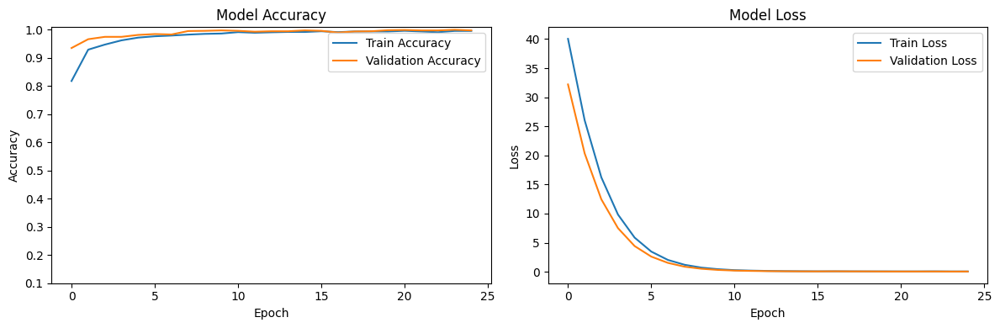

--------------------------------------------------------------------------------------------------
Results for Pre Trained Models - MobileNetV2:
103/103 ━━━━━━━━━━━━━━━━━━━━ 54s 498ms/step
103/103 ━━━━━━━━━━━━━━━━━━━━ 51s 498ms/step - accuracy: 0.9983 - loss: 0.0399
Training Loss:     0.039458077400922775
Training Accuracy: 0.998629093170166
--------------------------------------------------------------------------------------------------
21/21 ━━━━━━━━━━━━━━━━━━━━ 5s 246ms/step
21/21 ━━━━━━━━━━━━━━━━━━━━ 4s 175ms/step - accuracy: 1.0000 - loss: 0.0358
Validation Loss:     0.035610560327768326
Validation Accuracy: 1.0
--------------------------------------------------------------------------------------------------
12/12 ━━━━━━━━━━━━━━━━━━━━ 491s 45s/step
12/12 ━━━━━━━━━━━━━━━━━━━━ 4s 356ms/step - accuracy: 0.9831 - loss: 0.0975
Test Loss:     0.07159674912691116
Test Accuracy: 0.9908257126808167
----------------------------------------------------------------------------
Precision: 0.

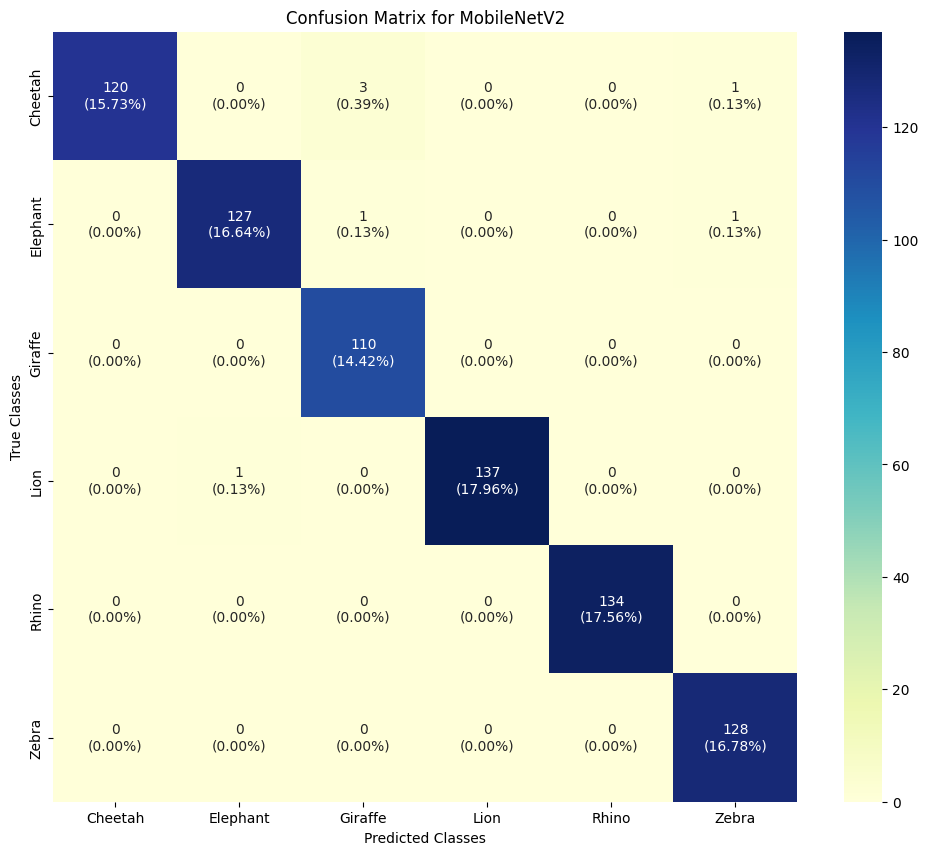

In [ ]:
# Extract the history data
history = MobileNetV2_history_1.history

# Plot training & validation accuracy values
plt.figure(figsize=(12, 4))

plt.subplot(1, 2, 1)
plt.plot(history['accuracy'], label='Train Accuracy')
plt.plot(history['val_accuracy'], label='Validation Accuracy')
plt.title('Model Accuracy')
plt.xlabel('Epoch')
plt.ylabel('Accuracy')
plt.legend(loc='best')
plt.yticks([0.1,0.2,0.3,0.4,0.5,0.6,0.7,0.8,0.9,1])

# Plot training & validation loss values
plt.subplot(1, 2, 2)
plt.plot(history['loss'], label='Train Loss')
plt.plot(history['val_loss'], label='Validation Loss')
plt.title('Model Loss')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.legend(loc='best')

# Show the plots
plt.tight_layout()
plt.show()


print("--------------------------------------------------------------------------------------------------")
print("Results for Pre Trained Models - MobileNetV2:")
## Calculating Training loss and accuracy.
predictions = MobileNetV2_model_1.predict(train_generator)
train_loss, train_accuracy = MobileNetV2_model_1.evaluate(train_generator, batch_size=batch_size)
print(f"Training Loss:     {train_loss}")
print(f"Training Accuracy: {train_accuracy}")
print("--------------------------------------------------------------------------------------------------")

# Calculating Validation loss and accuracy.
predictions = MobileNetV2_model_1.predict(validation_generator)
Validation_loss, Validation_accuracy = MobileNetV2_model_1.evaluate(validation_generator, batch_size=batch_size)
print(f"Validation Loss:     {Validation_loss}")
print(f"Validation Accuracy: {Validation_accuracy}")
print("--------------------------------------------------------------------------------------------------")

predictions = MobileNetV2_model_1.predict(test_generator)
test_loss, test_accuracy = MobileNetV2_model_1.evaluate(test_generator, batch_size=batch_size)
print(f"Test Loss:     {test_loss}")
print(f"Test Accuracy: {test_accuracy}")
print("----------------------------------------------------------------------------")

y_pred = np.argmax(predictions, axis=1)
y_true = test_generator.classes

## Calculating Precision, recall and F1-score.
precision, recall, f1_score, _ = precision_recall_fscore_support(y_true, y_pred, average='weighted')
print(f"Precision: {precision}")
print(f"Recall: {recall}")
print(f"F1 Score: {f1_score}")
print("--------------------------------------------------------------------------------------------------")

## Classification Report
print(classification_report(y_true, y_pred, target_names=labels.values()))
print("----------------------------------------------------------------------------")

## Plotting Confusion Matrix
cf_mtx = confusion_matrix(y_true, y_pred)

group_counts = ["{0:0.0f}".format(value) for value in cf_mtx.flatten()]
group_percentages = ["{0:.2%}".format(value) for value in cf_mtx.flatten()/np.sum(cf_mtx)]
box_labels = [f"{v1}\n({v2})" for v1, v2 in zip(group_counts, group_percentages)]
box_labels = np.asarray(box_labels).reshape(6, 6)
plt.figure(figsize = (12, 10))
sns.heatmap(cf_mtx, xticklabels=labels.values(), yticklabels=labels.values(),
           cmap="YlGnBu", fmt="", annot=box_labels)
plt.title("Confusion Matrix for MobileNetV2")
plt.xlabel('Predicted Classes')
plt.ylabel('True Classes')
plt.show()

2/2 ━━━━━━━━━━━━━━━━━━━━ 4s 12ms/step
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
2/2 ━━━━━━━━━━━━━━━━━━━━ 4s 4s/step
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step


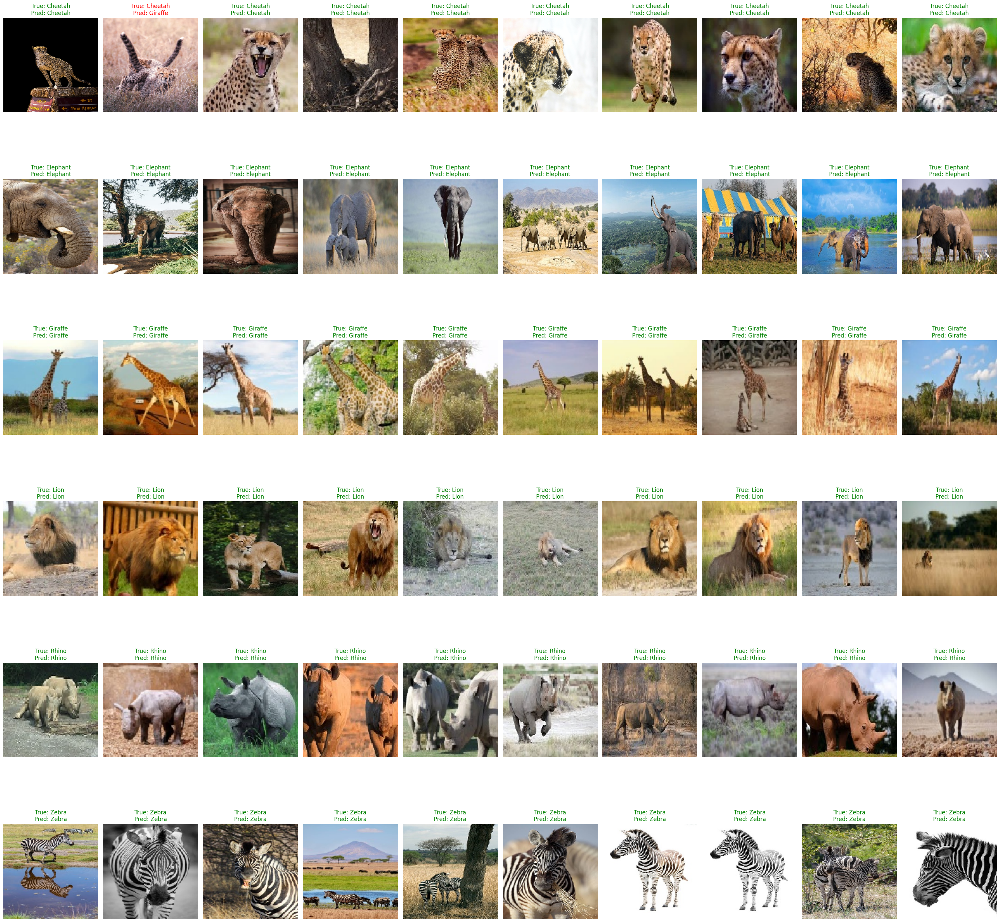

In [ ]:
def display_predictions_per_class(model, generator, class_labels, num_images_per_class=8):
    # Initialize lists to collect images, true classes, and predicted classes for each species
    image_batch = {label: [] for label in class_labels}
    true_classes_batch = {label: [] for label in class_labels}
    predicted_classes_batch = {label: [] for label in class_labels}

    # Number of classes
    num_classes = len(class_labels)

    # Continue extracting batches until we have enough images for each class
    while any(len(images) < num_images_per_class for images in image_batch.values()):
        images, labels = next(generator)
        true_classes = np.argmax(labels, axis=1)
        predictions = model.predict(images)
        predicted_classes = np.argmax(predictions, axis=1)

        for i in range(len(images)):
            true_label = class_labels[true_classes[i]]
            if len(image_batch[true_label]) < num_images_per_class:
                image_batch[true_label].append(images[i])
                true_classes_batch[true_label].append(true_classes[i])
                predicted_classes_batch[true_label].append(predicted_classes[i])

    # Plotting the images in a grid with their true and predicted labels
    plt.figure(figsize=(30, num_classes * 5))

    image_count = 0
    for idx, label in enumerate(class_labels):
        for i in range(num_images_per_class):
            image_count += 1
            ax = plt.subplot(num_classes, num_images_per_class, image_count)
            plt.imshow(image_batch[label][i])

            true_label = class_labels[true_classes_batch[label][i]]
            predicted_label = class_labels[predicted_classes_batch[label][i]]
            color = "green" if true_label == predicted_label else "red"

            plt.title(f"True: {true_label}\nPred: {predicted_label}", color=color)
            plt.axis("off")

    plt.tight_layout()
    plt.show()

# Display predictions for 10 images of each class from the test generator
class_labels = list(test_generator.class_indices.keys())
display_predictions_per_class(MobileNetV2_model_1, test_generator, class_labels, num_images_per_class=10)


### **InceptionV3**

#### Training

In [ ]:

# Load InceptionV3 model pre-trained on ImageNet, without the top classification layer
base_model = InceptionV3(input_shape=(img_width, img_height, 3), include_top=False, weights='imagenet')

# Unfreeze some layers of the base model
base_model.trainable = True
fine_tune_at = 100

for layer in base_model.layers[:fine_tune_at]:
    layer.trainable = False

# Add custom layers on top
x = base_model.output
x = layers.GlobalAveragePooling2D()(x)
x = layers.Dense(2048, activation='relu', kernel_regularizer=regularizers.l2(0.01))(x)
x = layers.Dropout(0.5)(x)
x = layers.Dense(1024, activation='relu', kernel_regularizer=regularizers.l2(0.01))(x)
x = layers.Dropout(0.5)(x)
predictions = layers.Dense(train_generator.num_classes, activation='softmax')(x)


# Define the model
InceptionV3_model = models.Model(inputs=base_model.input, outputs=predictions)
print(InceptionV3_model.summary())

Early_stopping = EarlyStopping(monitor='val_loss', patience=8, restore_best_weights=True)
optimizer = Adam(learning_rate=0.001)
InceptionV3_model.compile(optimizer=optimizer, loss=CategoricalCrossentropy(), metrics=['accuracy'])


InceptionV3_history = InceptionV3_model.fit(
    train_generator,
    epochs=20,
    validation_data=validation_generator,
    verbose=2,
    callbacks=[Early_stopping],
    class_weight=class_weights_dict
    )

87910968/87910968 ━━━━━━━━━━━━━━━━━━━━ 5s 0us/step


Model: "functional_7"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)              ┃ Output Shape           ┃        Param # ┃ Connected to           ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━┩
│ input_layer_7             │ (None, 150, 150, 3)    │              0 │ -                      │
│ (InputLayer)              │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2d (Conv2D)           │ (None, 74, 74, 32)     │            864 │ input_layer_7[0][0]    │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ batch_normalization       │ (None, 74, 74, 32)     │             96 │ conv2d[0][0]           │
│ (BatchNormalization)      │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ activation (Activation)   │ (None, 74, 74, 32)     │              0 │ batch_normalization[0… │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2d_1 (Conv2D)         │ (None, 72, 72, 32)     │          9,216 │ activation[0][0]       │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ batch_normalization_1     │ (None, 72, 72, 32)     │             96 │ conv2d_1[0][0]         │
│ (BatchNormalization)      │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ activation_1 (Activation) │ (None, 72, 72, 32)     │              0 │ batch_normalization_1… │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2d_2 (Conv2D)         │ (None, 72, 72, 64)     │         18,432 │ activation_1[0][0]     │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ batch_normalization_2     │ (None, 72, 72, 64)     │            192 │ conv2d_2[0][0]         │
│ (BatchNormalization)      │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ activation_2 (Activation) │ (None, 72, 72, 64)     │              0 │ batch_normalization_2… │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ max_pooling2d             │ (None, 35, 35, 64)     │              0 │ activation_2[0][0]     │
│ (MaxPooling2D)            │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2d_3 (Conv2D)         │ (None, 35, 35, 80)     │          5,120 │ max_pooling2d[0][0]    │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ batch_normalization_3     │ (None, 35, 35, 80)     │            240 │ conv2d_3[0][0]         │
│ (BatchNormalization)      │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ activation_3 (Activation) │ (None, 35, 35, 80)     │              0 │ batch_normalization_3… │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2d_4 (Conv2D)         │ (None, 33, 33, 192)    │        138,240 │ activation_3[0][0]     │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ batch_normalization_4     │ (None, 33, 33, 192)    │            576 │ conv2d_4[0][0]         │
│ (BatchNormalization)      │                        │                │                        │
├──────────────────────

 Total params: 28,103,462 (107.21 MB)

 Trainable params: 25,927,046 (98.90 MB)

 Non-trainable params: 2,176,416 (8.30 MB)

None
Epoch 1/20
103/103 - 144s - 1s/step - accuracy: 0.7907 - loss: 11.2996 - val_accuracy: 0.2235 - val_loss: 598.6212
Epoch 2/20
103/103 - 53s - 517ms/step - accuracy: 0.9074 - loss: 1.2201 - val_accuracy: 0.8307 - val_loss: 1.2132
Epoch 3/20
103/103 - 54s - 523ms/step - accuracy: 0.9359 - loss: 0.4996 - val_accuracy: 0.9191 - val_loss: 0.4765
Epoch 4/20
103/103 - 53s - 518ms/step - accuracy: 0.9462 - loss: 0.3489 - val_accuracy: 0.9825 - val_loss: 0.1956
Epoch 5/20
103/103 - 54s - 525ms/step - accuracy: 0.9599 - loss: 0.2646 - val_accuracy: 0.9756 - val_loss: 0.1826
Epoch 6/20
103/103 - 53s - 517ms/step - accuracy: 0.9587 - loss: 0.2687 - val_accuracy: 0.9580 - val_loss: 0.2186
Epoch 7/20
103/103 - 53s - 517ms/step - accuracy: 0.9624 - loss: 0.2338 - val_accuracy: 0.9863 - val_loss: 0.1327
Epoch 8/20
103/103 - 54s - 528ms/step - accuracy: 0.9752 - loss: 0.1754 - val_accuracy: 0.9832 - val_loss: 0.1481
Epoch 9/20
103/103 - 54s - 527ms/step - accuracy: 0.9729 - loss: 0.1938 - val_accu

#### Evaluation

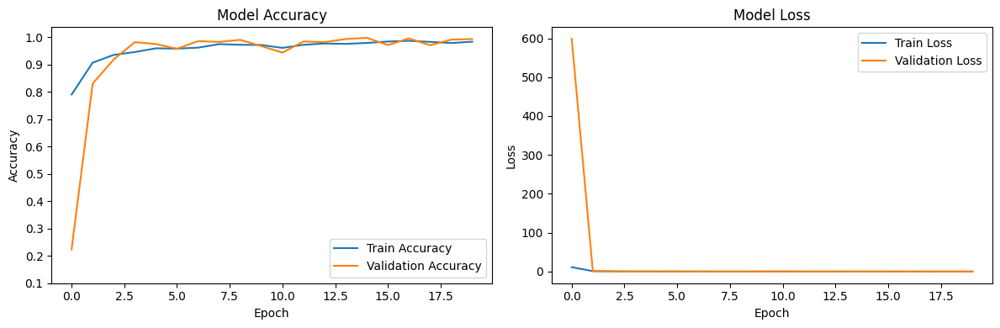

--------------------------------------------------------------------------------------------------
Results for Pre-Trained Model - Inception:
103/103 ━━━━━━━━━━━━━━━━━━━━ 59s 525ms/step
103/103 ━━━━━━━━━━━━━━━━━━━━ 52s 508ms/step - accuracy: 0.9865 - loss: 0.1020
Training Loss:     0.1073923408985138
Training Accuracy: 0.9859862923622131
--------------------------------------------------------------------------------------------------
21/21 ━━━━━━━━━━━━━━━━━━━━ 6s 293ms/step
21/21 ━━━━━━━━━━━━━━━━━━━━ 4s 181ms/step - accuracy: 0.9970 - loss: 0.0764
Validation Loss:     0.07805399596691132
Validation Accuracy: 0.9961861371994019
--------------------------------------------------------------------------------------------------
12/12 ━━━━━━━━━━━━━━━━━━━━ 9s 778ms/step
12/12 ━━━━━━━━━━━━━━━━━━━━ 6s 456ms/step - accuracy: 0.9704 - loss: 0.1808
Test Loss:     0.18081974983215332
Test Accuracy: 0.9659239649772644
----------------------------------------------------------------------------
Pre

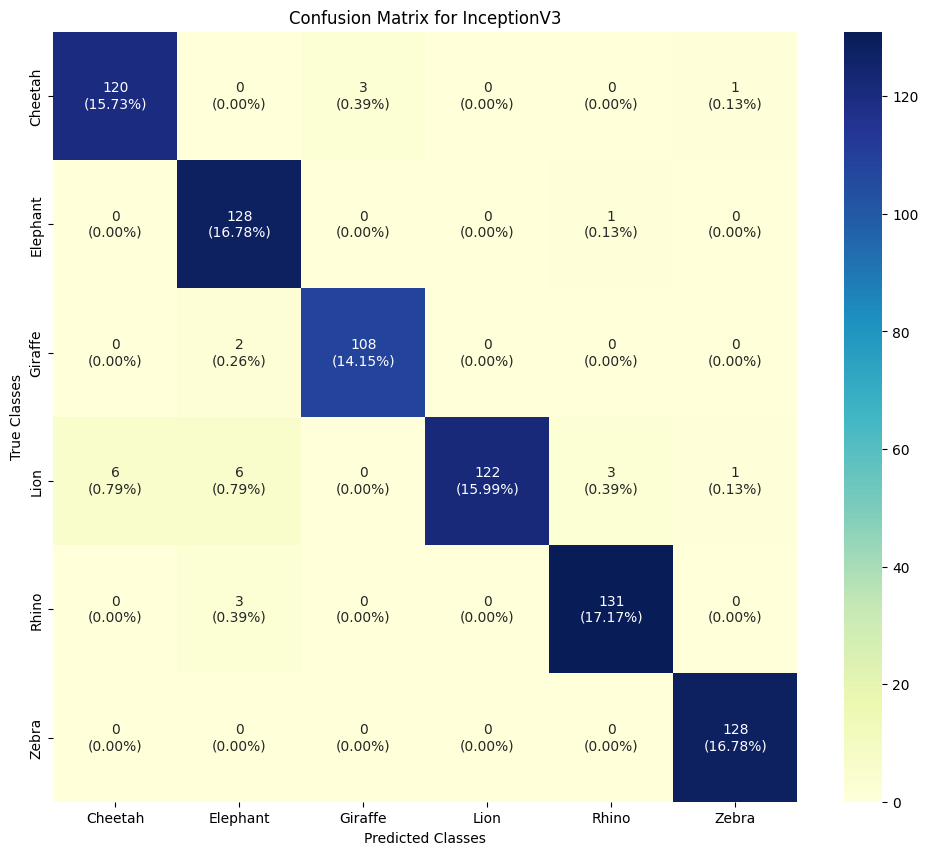

In [ ]:
# Extract the history data
history = InceptionV3_history.history

# Plot training & validation accuracy values
plt.figure(figsize=(12, 4))

plt.subplot(1, 2, 1)
plt.plot(history['accuracy'], label='Train Accuracy')
plt.plot(history['val_accuracy'], label='Validation Accuracy')
plt.title('Model Accuracy')
plt.xlabel('Epoch')
plt.ylabel('Accuracy')
plt.legend(loc='best')
plt.yticks([0.1,0.2,0.3,0.4,0.5,0.6,0.7,0.8,0.9,1])

# Plot training & validation loss values
plt.subplot(1, 2, 2)
plt.plot(history['loss'], label='Train Loss')
plt.plot(history['val_loss'], label='Validation Loss')
plt.title('Model Loss')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.legend(loc='best')

# Show the plots
plt.tight_layout()
plt.show()

print("--------------------------------------------------------------------------------------------------")
print("Results for Pre-Trained Model - Inception:")
## Calculating Training loss and accuracy.
predictions = InceptionV3_model.predict(train_generator)
train_loss, train_accuracy = InceptionV3_model.evaluate(train_generator, batch_size=batch_size)
print(f"Training Loss:     {train_loss}")
print(f"Training Accuracy: {train_accuracy}")
print("--------------------------------------------------------------------------------------------------")

# Calculating Validation loss and accuracy.
predictions = InceptionV3_model.predict(validation_generator)
Validation_loss, Validation_accuracy = InceptionV3_model.evaluate(validation_generator, batch_size=batch_size)
print(f"Validation Loss:     {Validation_loss}")
print(f"Validation Accuracy: {Validation_accuracy}")
print("--------------------------------------------------------------------------------------------------")

predictions = InceptionV3_model.predict(test_generator)
test_loss, test_accuracy = InceptionV3_model.evaluate(test_generator, batch_size=batch_size)
print(f"Test Loss:     {test_loss}")
print(f"Test Accuracy: {test_accuracy}")
print("----------------------------------------------------------------------------")

y_pred = np.argmax(predictions, axis=1)
y_true = test_generator.classes

## Calculating Precision, recall and F1-score.
precision, recall, f1_score, _ = precision_recall_fscore_support(y_true, y_pred, average='weighted')
print(f"Precision: {precision}")
print(f"Recall: {recall}")
print(f"F1 Score: {f1_score}")
print("--------------------------------------------------------------------------------------------------")


## Classification Report
print(classification_report(y_true, y_pred, target_names=labels.values()))
print("----------------------------------------------------------------------------")

## Plotting Confusion Matrix
cf_mtx = confusion_matrix(y_true, y_pred)

group_counts = ["{0:0.0f}".format(value) for value in cf_mtx.flatten()]
group_percentages = ["{0:.2%}".format(value) for value in cf_mtx.flatten()/np.sum(cf_mtx)]
box_labels = [f"{v1}\n({v2})" for v1, v2 in zip(group_counts, group_percentages)]
box_labels = np.asarray(box_labels).reshape(6, 6)

plt.figure(figsize = (12, 10))
sns.heatmap(cf_mtx, xticklabels=labels.values(), yticklabels=labels.values(),
           cmap="YlGnBu", fmt="", annot=box_labels)
plt.title("Confusion Matrix for InceptionV3")
plt.xlabel('Predicted Classes')
plt.ylabel('True Classes')
plt.show()

2/2 ━━━━━━━━━━━━━━━━━━━━ 8s 15ms/step
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 38ms/step
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 41ms/step
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 40ms/step
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 43ms/step
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 40ms/step
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 40ms/step


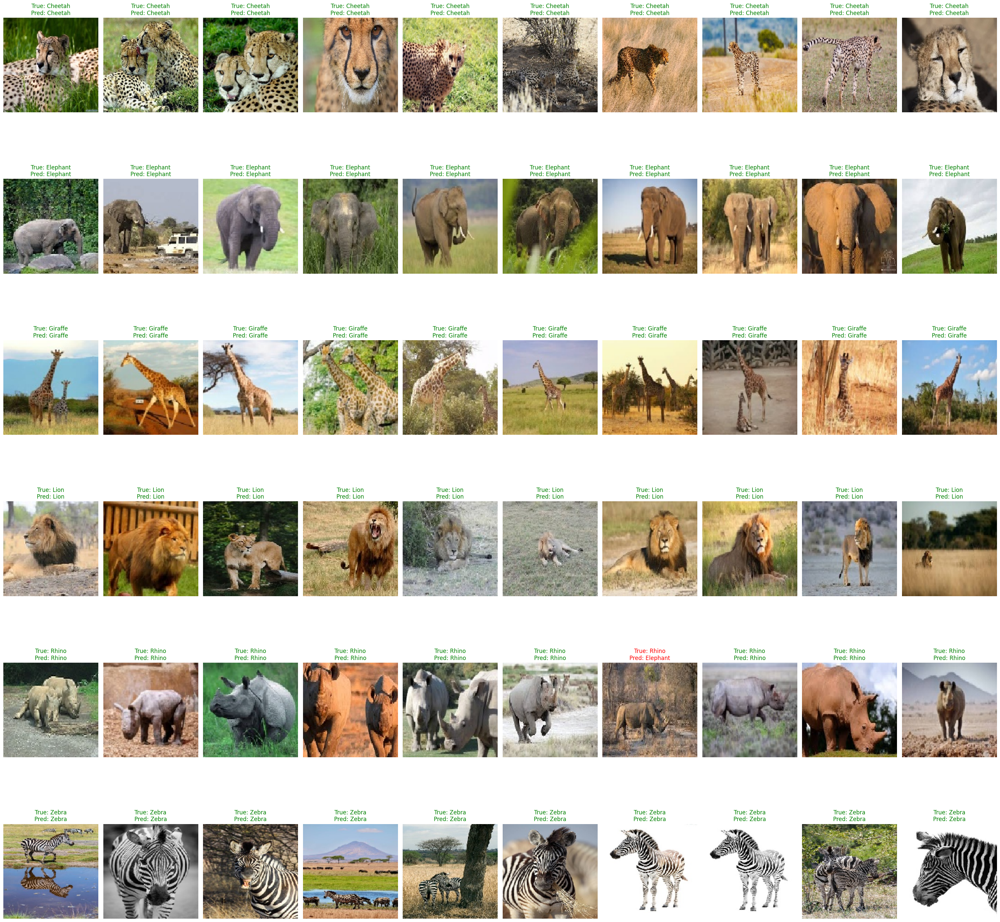

In [ ]:
def display_predictions_per_class(model, generator, class_labels, num_images_per_class=8):
    # Initialize lists to collect images, true classes, and predicted classes for each species
    image_batch = {label: [] for label in class_labels}
    true_classes_batch = {label: [] for label in class_labels}
    predicted_classes_batch = {label: [] for label in class_labels}

    # Number of classes
    num_classes = len(class_labels)

    # Continue extracting batches until we have enough images for each class
    while any(len(images) < num_images_per_class for images in image_batch.values()):
        images, labels = next(generator)
        true_classes = np.argmax(labels, axis=1)
        predictions = model.predict(images)
        predicted_classes = np.argmax(predictions, axis=1)

        for i in range(len(images)):
            true_label = class_labels[true_classes[i]]
            if len(image_batch[true_label]) < num_images_per_class:
                image_batch[true_label].append(images[i])
                true_classes_batch[true_label].append(true_classes[i])
                predicted_classes_batch[true_label].append(predicted_classes[i])

    # Plotting the images in a grid with their true and predicted labels
    plt.figure(figsize=(30, num_classes * 5))

    image_count = 0
    for idx, label in enumerate(class_labels):
        for i in range(num_images_per_class):
            image_count += 1
            ax = plt.subplot(num_classes, num_images_per_class, image_count)
            plt.imshow(image_batch[label][i])

            true_label = class_labels[true_classes_batch[label][i]]
            predicted_label = class_labels[predicted_classes_batch[label][i]]
            color = "green" if true_label == predicted_label else "red"

            plt.title(f"True: {true_label}\nPred: {predicted_label}", color=color)
            plt.axis("off")

    plt.tight_layout()
    plt.show()

# Display predictions for 10 images of each class from the test generator
class_labels = list(test_generator.class_indices.keys())
display_predictions_per_class(InceptionV3_model, test_generator, class_labels, num_images_per_class=10)
